<a href="https://colab.research.google.com/github/abhijadhav14/Image-Compression-Using-GAN/blob/main/Gan_img_comp_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
import matplotlib.pyplot as plt
import os

In [ ]:
# Check if CUDA is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


In [ ]:
import torch

torch.cuda.empty_cache()




In [ ]:
# Custom Dataset class
class CustomDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_list = os.listdir(root_dir)

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        img_path = os.path.join(self.root_dir, self.image_list[idx])
        image = Image.open(img_path).convert("RGB")

        if self.transform:
            image = self.transform(image)

        return image

In [ ]:
# Autoencoder model
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(16, 32, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(32, 16, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 3, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

In [ ]:
# Calculate PSNR and SSIM

def calculate_metrics(original, compressed):
    psnr_value = psnr(original, compressed)

    # Set win_size based on the smaller side of the image
    win_size = min(original.shape[0], original.shape[1], 11)

    if original.max() > 1:
        original = original / 255.0  # Normalize to [0, 1]

    if compressed.max() > 1:
        compressed = compressed / 255.0  # Normalize to [0, 1]

    ssim_value, _ = ssim(original, compressed, win_size=win_size, full=True)
    return psnr_value, ssim_value

In [ ]:
# Compression Ratio calculation
def calculate_compression_ratio(original_size, compressed_size):
    return original_size / compressed_size



In [ ]:
# Display images
def display_images(original, compressed):
    fig, axes = plt.subplots(1, 2, figsize=(8, 4))
    axes[0].imshow(original)
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    axes[1].imshow(compressed)
    axes[1].set_title('Compressed Image')
    axes[1].axis('off')

    plt.show()

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Custom dataset and dataloader
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Adjust size as needed
    transforms.ToTensor(),
])
dataset = CustomDataset(root_dir='/content/drive/MyDrive/98/', transform=transform)
dataloader = DataLoader(dataset, batch_size=1, shuffle=True, num_workers=4)


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


In [ ]:
# Instantiate the autoencoder
model = Autoencoder().to('cpu')
#model = model.to('cpu')


criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)


In [ ]:
# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    for data in dataloader:
        data = data.to('cpu')
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, data)
        loss.backward()
        optimizer.step()

    print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

Epoch [1/10], Loss: 0.0245
Epoch [2/10], Loss: 0.0105
Epoch [3/10], Loss: 0.0037
Epoch [4/10], Loss: 0.0070
Epoch [5/10], Loss: 0.0101
Epoch [6/10], Loss: 0.0140
Epoch [7/10], Loss: 0.0075
Epoch [8/10], Loss: 0.0058
Epoch [9/10], Loss: 0.0034
Epoch [10/10], Loss: 0.0036


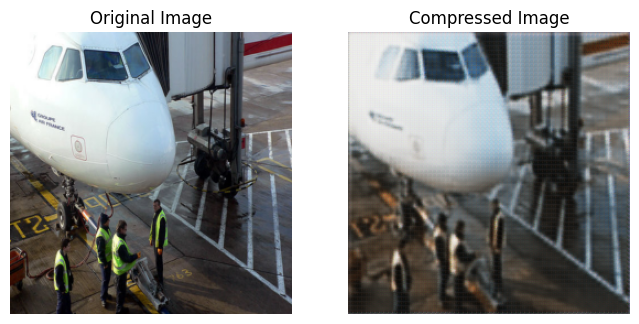

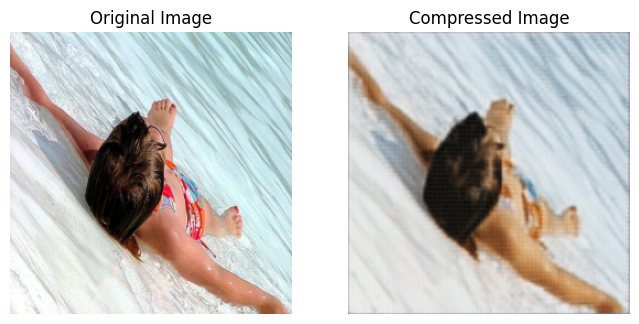

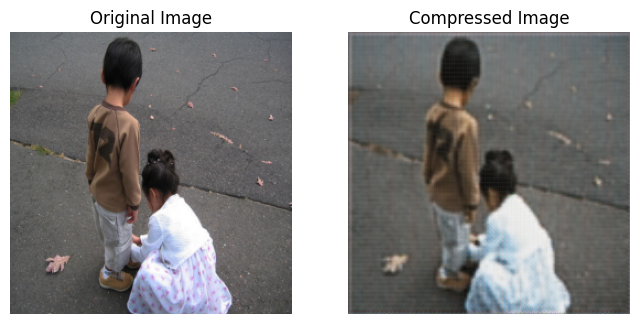

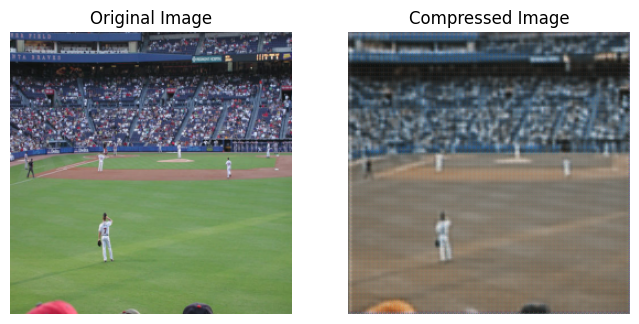

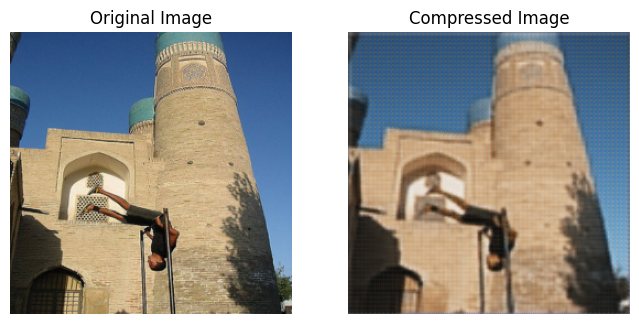

...

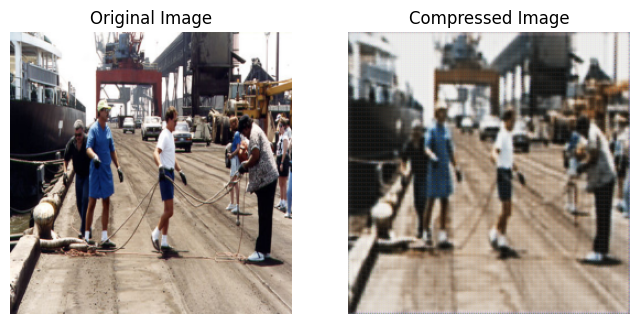

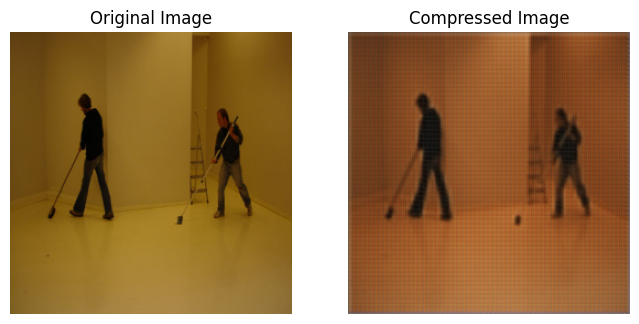

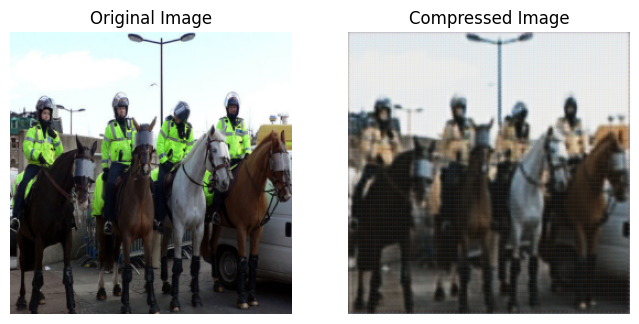

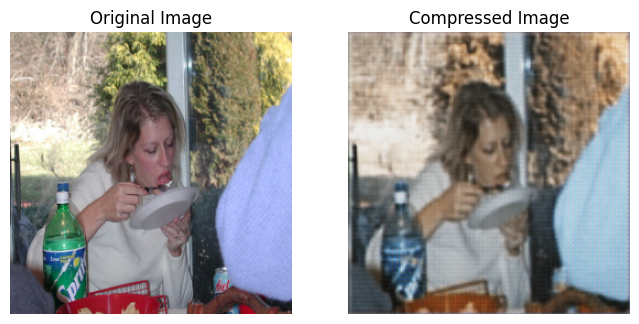

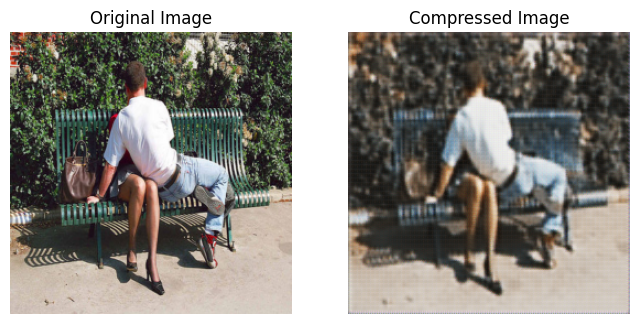

In [ ]:
# Evaluation loop for metrics and display images
with torch.no_grad():
    for data in dataloader:
        data = data.to('cpu')
        output = model(data)

        # Convert tensors to numpy arrays
        original_np = data.cpu().numpy().squeeze().transpose(1, 2, 0)
        compressed_np = output.cpu().numpy().squeeze().transpose(1, 2, 0)

        # Display images
        display_images(original_np, compressed_np)





In [ ]:
# Evaluation loop for metrics
psnr_sum = 0.0
ssim_sum = 0.0
original_size_sum = 0
compressed_size_sum = 0

with torch.no_grad():
    for data in dataloader:
        data = data.to(device)
        output = model(data)

        # Convert tensors to numpy arrays
        original_np = data.cpu().numpy()
        compressed_np = output.cpu().numpy()

        # Calculate metrics
        for i in range(original_np.shape[0]):
            psnr_value, ssim_value = calculate_metrics(original_np[i], compressed_np[i])
            psnr_sum += psnr_value
            ssim_sum += ssim_value

            # Calculate original and compressed sizes
            original_size_sum += original_np[i].nbytes
            compressed_size_sum += compressed_np[i].nbytes

# Average metrics over the dataset
average_psnr = psnr_sum / len(dataset)
average_ssim = ssim_sum / len(dataset)
compression_ratio = calculate_compression_ratio(original_size_sum, compressed_size_sum)

print(f'Average PSNR: {average_psnr:.4f}')
print(f'Average SSIM: {average_ssim:.4f}')
print(f'Compression Ratio: {compression_ratio:.4f}')

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Average PSNR: 23.7463
Average SSIM: 0.8010
Compression Ratio: 1.0000


In [ ]:
print("PSNR: ", psnr_sum)
print("SSIM: ",ssim_sum)

PSNR:  1899.7034382429067
SSIM:  64.08359852663953
